In [1]:
import os
import sys

import cv2
import numpy as np
import pandas as pd
import albumentations as albu
from tqdm import tqdm

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import segmentation_models_pytorch as smp
import segmentation_models_pytorch.utils.metrics
from torch.utils.data import Dataset, DataLoader
from bounding_box import bounding_box as bb
import matplotlib.pyplot as plt
from torchmetrics.detection import IntersectionOverUnion as IOU

import torchvision
from torchvision import transforms as T
from PIL import Image

In [2]:
device = "cuda" if torch.cuda.is_available() else "cpu"

print(f"Use '{device}' device!")

Use 'cuda' device!


In [9]:
def generate_synthetic_data(path, file_type):

    picture_samples = [os.path.join(path, file) for file in os.listdir(path) if file.endswith(file_type)]


    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
    model.eval()


    transform = T.ToTensor()
    train_list = [transform(Image.open(i)) for i in picture_samples]


    with torch.no_grad():
        pred_list = [model([i]) for i in train_list]


    list_data = ['boxes', 'labels', 'scores']


    for i in pred_list:
        for k in list_data:
            i[0][k] = i[0][k].tolist()


    lst_range = [i for i in range(len(pred_list))]


    c = 0
    for i in lst_range:
        while c < len(pred_list[i][0]['labels']):
            pred_list[i][0]['labels'][c] = f"p_{i + 1}"
            c += 1
        c = 0


    total_boxes_lst = []
    for i in pred_list:
        for k in i[0]['boxes']:
            total_boxes_lst.append(k)

    total_labels_lst = []
    for i in pred_list:
        for k in i[0]['labels']:
            total_labels_lst.append(k)

    total_scores_lst = []
    for i in pred_list:
        for k in i[0]['scores']:
            total_scores_lst.append(k)


    boxes_array = np.array(total_boxes_lst)
    boxes_array = boxes_array.astype(int)

    res_boxes = boxes_array.tolist()

    labels_array = np.array(total_labels_lst)

    scores_array = np.array(total_scores_lst)
    scores_array = np.round(scores_array, 1)

    res_scores = scores_array.tolist()

    df_boxes = pd.DataFrame(boxes_array, columns=['X', 'Y', 'H', 'W'])

    df_labels = pd.DataFrame(labels_array, columns=['Labels'])

    df_scores = pd.DataFrame(scores_array, columns=['Scores'])

    df_boxes['Labels'] = df_labels

    df_boxes['Scores'] = df_scores
    df_boxes = df_boxes.T

    column_names = df_boxes.columns.tolist()

    return res_boxes, res_scores, column_names, df_boxes, picture_samples


res_boxes, res_scores, column_names, df_boxes, picture_samples = generate_synthetic_data("D:/dataset_02/train/", ".jpg")

C:\Users\User\AppData\Roaming\Python\Python311\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\User\AppData\Roaming\Python\Python311\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [4]:
def NMS(boxes, scores, threshold=0.5):

    order = sorted(range(len(scores)), key=lambda i: scores[i], reverse=True)
    keep = []
    result_list = []
    while order:
        i = order.pop(0)
        keep.append(i)
        for j in order:

            intersection = max(
                0, min(boxes[i][2], boxes[j][2]) - max(boxes[i][0], boxes[j][0])
            ) * max(0, min(boxes[i][3], boxes[j][3]) - max(boxes[i][1], boxes[j][1]))
            union = (
                (boxes[i][2] - boxes[i][0]) * (boxes[i][3] - boxes[i][1])
                + (boxes[j][2] - boxes[j][0]) * (boxes[j][3] - boxes[j][1])
                - intersection
            )
            iou = intersection / union

            if iou > threshold:
                order.remove(j)

    for k in keep:
        for c in column_names:
            if k == c:
                result_list.append(df_boxes[k].tolist())

    c = 0
    while c < len(result_list):
        result_list[c].append(keep[c])
        c = c + 1

    return result_list


res_data = NMS(res_boxes, res_scores)

In [8]:
res_df = pd.DataFrame(res_data, columns=['X', 'Y', 'H', 'W', 'Labels', 'Score', 'Prev_ID'])
res_df = res_df.sort_values(by='Labels', ascending=True).reset_index(drop=True)
res_df = res_df.drop('Prev_ID', axis=1)
res_df.head()

,X,Y,H,W,Labels,Score
0,638,81,983,796,p_1,1.0
1,143,470,425,804,p_1,0.1
2,396,547,437,578,p_1,0.1
3,377,547,431,606,p_1,0.1
4,696,427,964,789,p_1,0.1


In [10]:
imglbb = []
imgsbb = []
for i in picture_samples:
    sampleimage = cv2.imread(i)
    sampleimage = cv2.cvtColor(sampleimage,cv2.COLOR_BGR2RGB)
    sampleimageallbb = sampleimage.copy()
    sampleimagenmsbb = sampleimage.copy()
    imglbb.append(sampleimageallbb)
    imgsbb.append(sampleimagenmsbb)

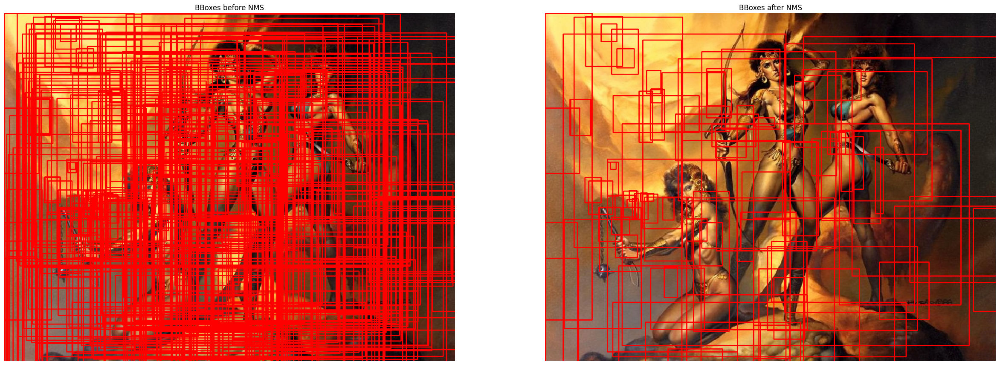

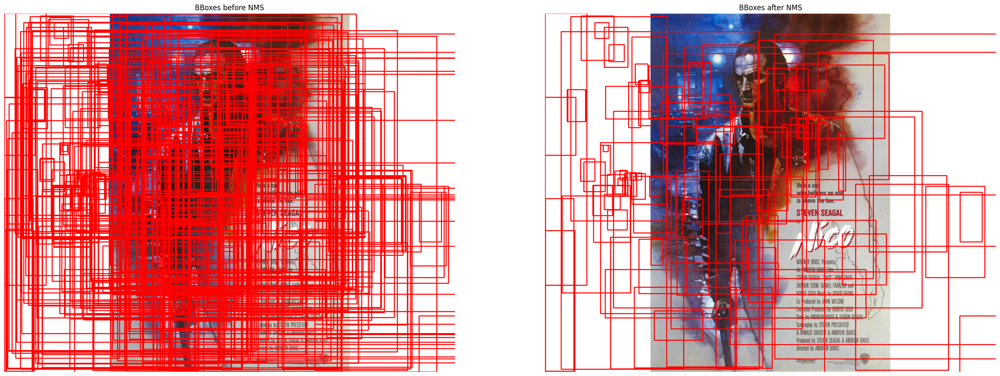

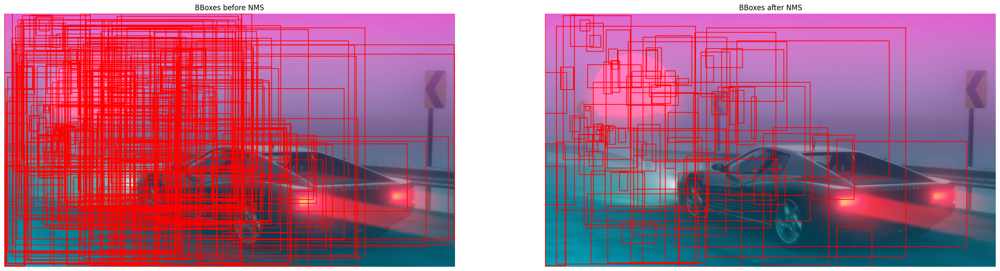

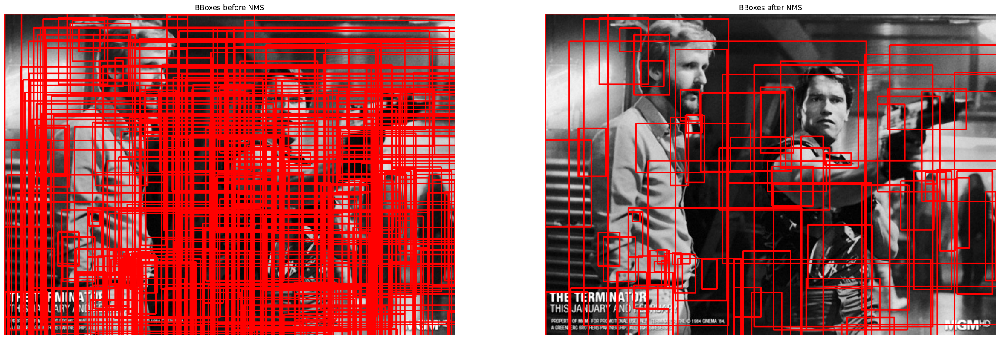

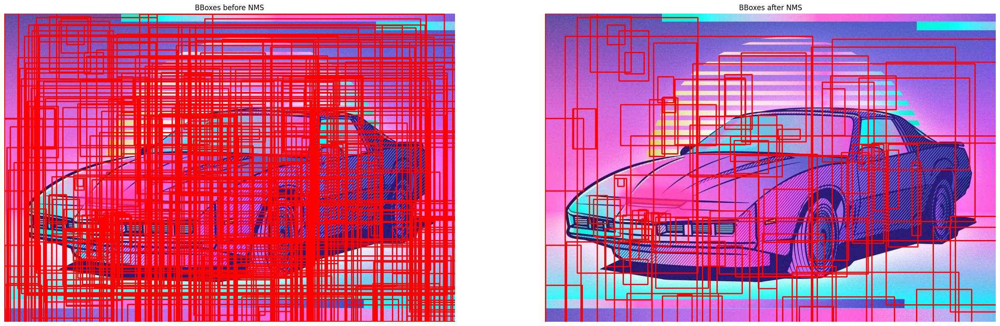

...

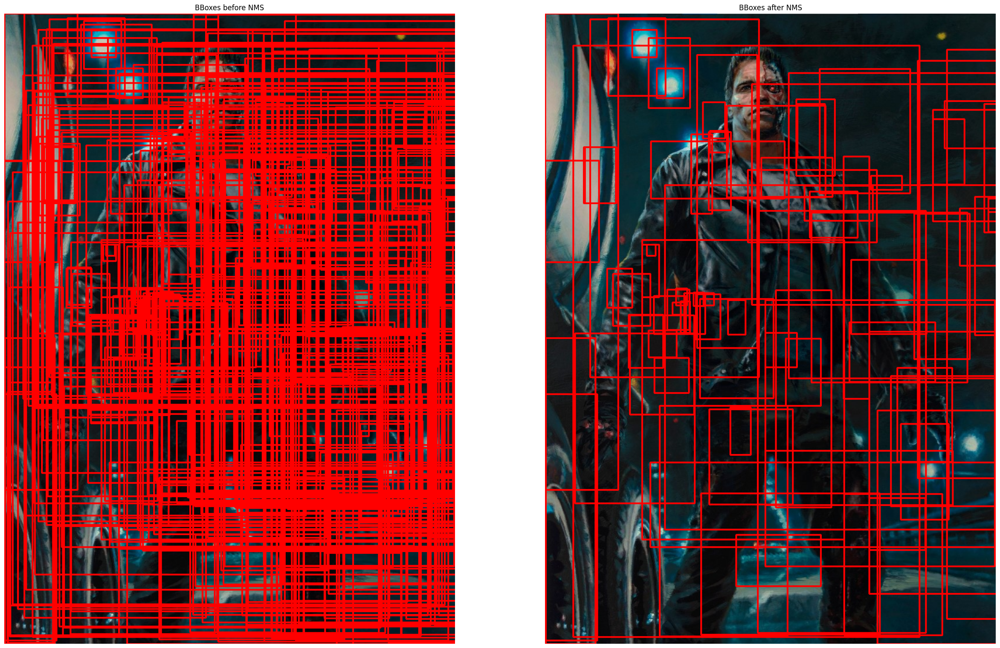

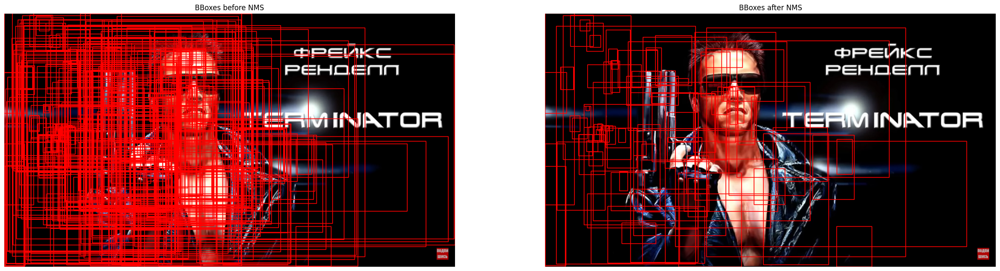

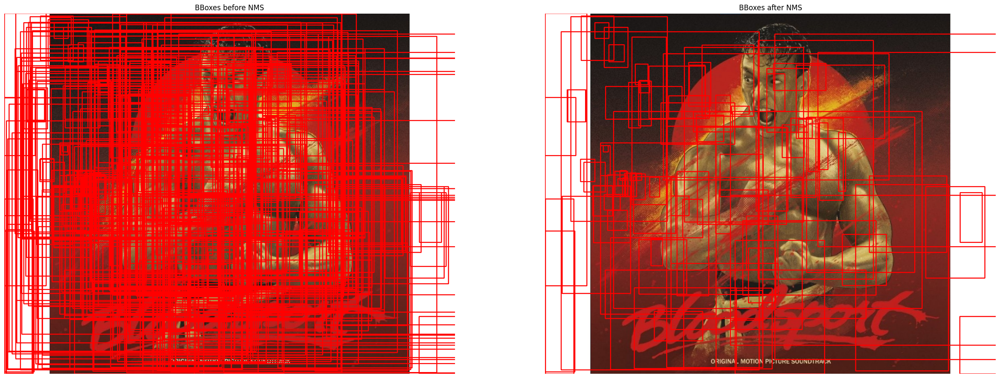

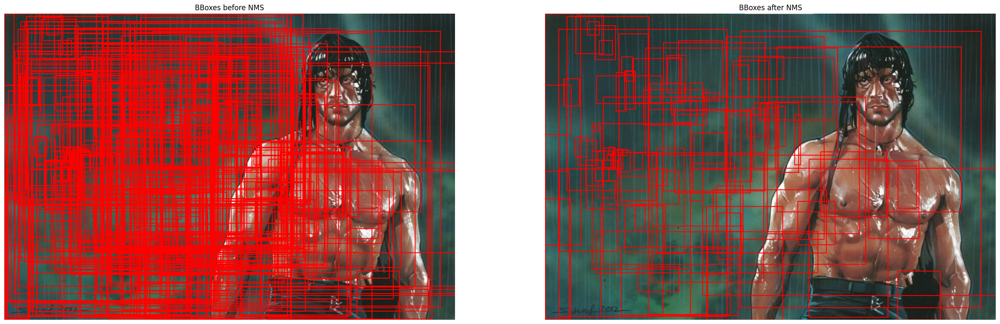

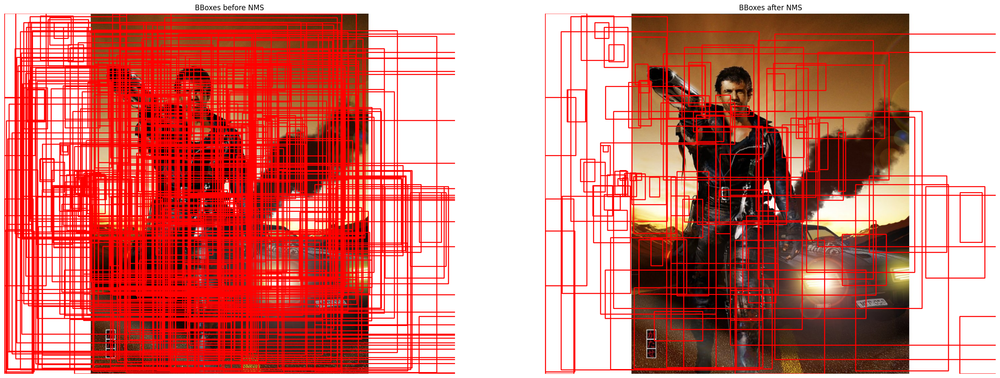

In [11]:
for i in imglbb:
    for bbox in res_boxes:
        top_left = bbox[0],bbox[1]
        bottom_right = bbox[2],bbox[3]
        cv2.rectangle(i,top_left, bottom_right,(255, 0, 0), 2)
    
bboxes_after_nms = NMS(res_boxes, res_scores, 0.3)

for k in imgsbb:
    for bbox in bboxes_after_nms:
        top_left = bbox[0],bbox[1]
        bottom_right = bbox[2],bbox[3]
        cv2.rectangle(k,top_left, bottom_right,(255, 0, 0), 2)
    
c = 0
while c < len(imglbb):
    image_list = [imglbb[c], imgsbb[c]]
    titles = ["BBoxes before NMS","BBoxes after NMS"]
    c = c + 1

    fig, axes = plt.subplots(1, 2,figsize=(30,20))
    for axis,(image,title) in zip(axes,zip(image_list,titles)):
        axis.imshow(image)
        axis.axis('off')
        axis.set_title(title)
    plt.show()